In [1]:
#imports
%matplotlib inline
%reload_ext autoreload
%autoreload 2
from fastai.conv_learner import *
from fastai.dataset import *
from fastai.learner import *
from fastai.structured import *
from fastai.column_data import *
import pdb
import xmltodict 
from PIL import ImageDraw, ImageFont
from matplotlib import patches, patheffects
from matplotlib.image import imread
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
from torch.autograd import Variable
from os import listdir
import statistics
import sys
import cv2
import argparse
import os
import csv
sys.path.append('/media/antonio/ubuntuhdd/open2/openpose/build/python');
from openpose import pyopenpose as op

In [2]:
PATH="/media/antonio/ubuntuhdd/data/"
IPATH="buenasweapons/"
BBPATH="WeaponS_bbox/"
bbs={}

for res in listdir(PATH + IPATH):
    with open(PATH + BBPATH + res[:-3]+"xml") as fd:
        bbs[res] = xmltodict.parse(fd.read())
        
def bbs_size(ID):
    list_bbs= bbs[ID]['annotation']['object']
    res={}
    if isinstance(list_bbs,list):
        res= [[int(o['bndbox']['ymin']), int(o['bndbox']['xmin']), int(o['bndbox']['ymax']), int(o['bndbox']['xmax'])]for o in list_bbs ]
    else:
        res=[int(list_bbs['bndbox']['ymin']), int(list_bbs['bndbox']['xmin']), int(list_bbs['bndbox']['ymax']) , int(list_bbs['bndbox']['xmax'])]
    return res
    
    
bb_sizes={}
for ID in bbs.keys():
    bb_sizes[ID[:-4]]=bbs_size(ID) 
for i in range(3000,5961):
    bb_sizes[str(i)]=[]
    def bb_hw(a): return np.array([a[1],a[0],a[3]-a[1]+1,a[2]-a[0]+1])
#Convierte arrays y en cadenas ej: [[5,3,2,1],[7,4,5,2]]  ------> "5 3 2 1 7 4 5 2 "

def str_from_array(array):
    res=""
    if len(array) == 0 : return ""
    if isinstance(array[0],list):
        for i in array:
            res=res+str(i[0])+" "+str(i[1])+" "+str(i[2])+" "+str(i[3])+" "
    else:
        res=res+str(array[0])+" "+str(array[1])+" "+str(array[2])+" "+str(array[3])+" "
    return res[0:len(res)-1]
def generate_cat_array(a):
    arr=[]
    for o in a:
        if int(o)<3000:
            arr.append("gun")
        else:
            arr.append("notgun")
    return arr

def generate_numeric_cat_array():
    arr=[]
    for o in listdir(PATH+IPATH):
        if isinstance(bb_sizes[str(o[:-4])][0],list):
            arr.append(np.array([0 for i in bb_sizes[str(o[:-4])]]))
        else:
            arr.append(np.array([0]))
        
            
    return arr


In [3]:
def show_img(img, figsize=None, ax=None,folder="testing/"):
    im=mpimg.imread(PATH+folder+img)
        
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    ax.imshow(im)
  #  ax.set_xticks(np.linspace(0, 224, 8))
   # ax.set_yticks(np.linspace(0, 224, 8))
   # ax.grid()
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    return ax

def draw_outline(o, lw):
    o.set_path_effects([patheffects.Stroke(
        linewidth=lw, foreground='black'), patheffects.Normal()])

# def draw_rect(ax, b, color='white'):
#     patch = ax.add_patch(patches.Rectangle(b[:2], b[2]-b[0], b[3]-b[1], fill=False, edgecolor=color, lw=2))
#     draw_outline(patch, 4)
def draw_rect(ax, b, color='white'):
    patch = ax.add_patch(patches.Rectangle(b[:2], *b[-2:], fill=False, edgecolor=color, lw=2))
    draw_outline(patch, 4)

def draw_text(ax, xy, txt, sz=14, color='red'):
    text = ax.text(*xy, txt,
        verticalalignment='top', color=color, fontsize=sz, weight='bold')
    draw_outline(text, 1)

def draw_im(im, ann):
    ax = show_img(im, figsize=(16,8))
    if len(ann) == 0:
        return
    if isinstance(ann[0],list):
        for b in ann:
            draw_rect(ax, b)
            draw_text(ax, b[:2], "GUN ", sz=16)
    else:
            draw_rect(ax, ann)
            draw_text(ax, ann[:2], "GUN ", sz=16)

def draw_idx(i):
    im_a = bb_sizes[i]
    draw_im(i, im_a)

In [4]:
CLAS_CSV = PATH+'tmp/clas.csv'
MBB_CSV = PATH+'/tmp/mbb.csv'
f_model=resnet34
sz=224
bs=64

In [5]:
df = pd.DataFrame({'fn': [res for res in listdir(PATH + IPATH)], 'bbox': [str_from_array(bb_sizes[str(res[:-4])]) for res in listdir(PATH + IPATH)]}, columns=['fn','bbox'])
df.to_csv(MBB_CSV, index=False)

In [6]:
df[100:120]

,fn,bbox
100,2802.jpg,185 99 409 228
101,471.jpg,298 65 607 315
102,1751.jpg,114 61 262 309
103,1925.jpg,3 3 203 383
104,2086.jpg,136 59 253 139
105,1958.jpg,236 446 695 721
106,2057.jpg,354 385 449 451
107,543.jpg,131 130 167 176
108,194.jpg,1 1 141 184
109,835.jpg,235 54 615 965


In [7]:
aug_tfms = [RandomRotate(3, p=0.5, tfm_y=TfmType.COORD),
            RandomLighting(0.05, 0.05, tfm_y=TfmType.COORD),
            RandomFlip(tfm_y=TfmType.COORD),
           RandomZoom(0,zoom_min=-0.2,tfm_y=TfmType.COORD)]
tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, tfm_y=TfmType.COORD, aug_tfms=aug_tfms)
md1 = ImageClassifierData.from_csv(PATH, IPATH, MBB_CSV, tfms=tfms, bs=bs, continuous=True, num_workers=6)

In [8]:
val_idxs = get_cv_idxs(len([res for res in listdir(PATH+IPATH)]))
((val_mcs,trn_mcs),) = split_by_idx(val_idxs, np.array(generate_numeric_cat_array()))


In [9]:
import matplotlib.cm as cmx
import matplotlib.colors as mcolors
from cycler import cycler
def show_img_(ID, figsize=None, ax=None):
    if isinstance(ID,str):
        im=mpimg.imread(PATH+IPATH+ID+".jpg")
        
    else:
        im=ID
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    ax.imshow(im)
  #  ax.set_xticks(np.linspace(0, 224, 8))
   # ax.set_yticks(np.linspace(0, 224, 8))
    ax.grid()
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    return ax
def get_cmap(N):
    color_norm  = mcolors.Normalize(vmin=0, vmax=N-1)
    return cmx.ScalarMappable(norm=color_norm, cmap='Set3').to_rgba

num_colr = 12
cmap = get_cmap(num_colr)
colr_list = [cmap(float(x)) for x in range(num_colr)]

def show_ground_truth(ax, im, bbox, clas=None, prs=None, thresh=0.3):
    bb = [bb_hw(o) for o in bbox.reshape(-1,4)]
    if prs is None:  prs  = [None]*len(bb)
    if clas is None: clas = [None]*len(bb)
    ax = show_img_(im, ax=ax)
    for i,(b,c,pr) in enumerate(zip(bb, clas, prs)):
        if((b[2]>0) and (pr is None or pr > thresh)):
            draw_rect(ax, b, color=colr_list[i%num_colr])
            txt = f'{i}: '
            if c is not None: txt += ('bg' if c==len(id2cat) else id2cat[c])
            if pr is not None: txt += f' {pr:.2f}'
            draw_text(ax, b[:2], txt, color=colr_list[i%num_colr])

class ConcatLblDataset(Dataset):
    def __init__(self, ds, y2):
        self.ds,self.y2 = ds,y2
        self.sz = ds.sz
    def __len__(self): return len(self.ds)
    
    def __getitem__(self, i):
        x,y = self.ds[i]
        return (x, (y,self.y2[i]))

trn_ds2 = ConcatLblDataset(md1.trn_ds, trn_mcs)
val_ds2 = ConcatLblDataset(md1.val_ds, val_mcs)
md1.trn_dl.dataset = trn_ds2
md1.val_dl.dataset = val_ds2

x,y=to_np(next(iter(md1.val_dl)))
x=md1.val_ds.ds.denorm(x)

x,y=to_np(next(iter(md1.trn_dl)))
x=md1.trn_ds.ds.denorm(x)

id2cat=['gun']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


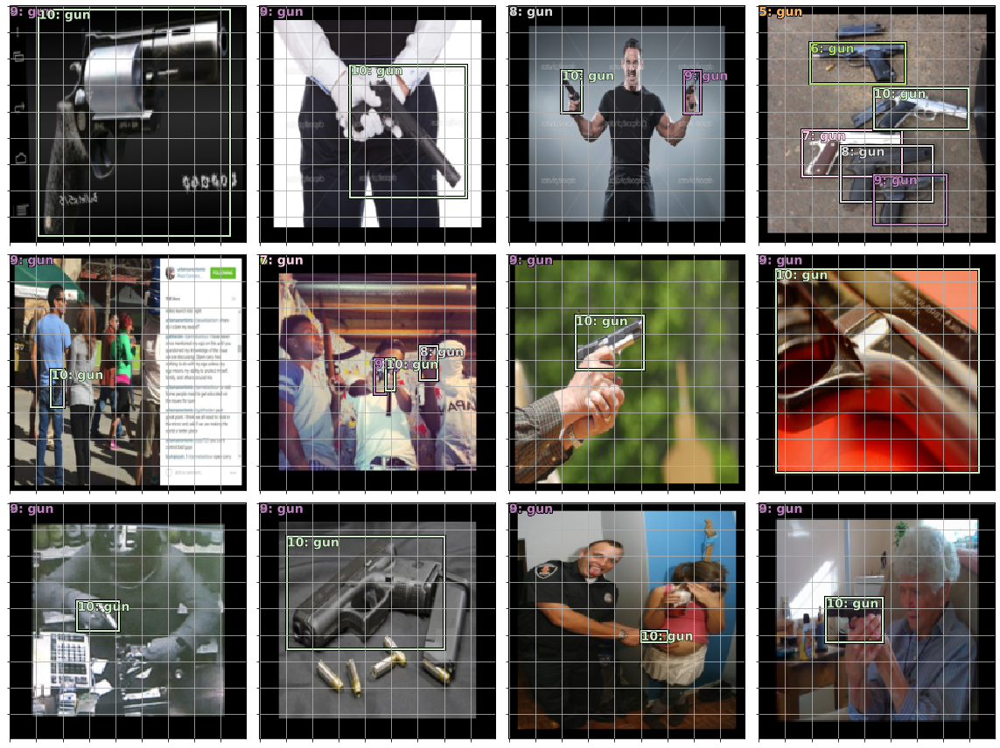

In [10]:
fig, axes = plt.subplots(3, 4, figsize=(16, 12))
for i,ax in enumerate(axes.flat):
    show_ground_truth(ax, x[i], y[0][i], y[1][i])
plt.tight_layout()

In [11]:
def hw2corners(ctr, hw): return torch.cat([ctr-hw/2, ctr+hw/2], dim=1)

In [12]:
id2cat=['gun']
n_clas = len(id2cat)+1
k=1
n_act = k*(4+n_clas)


In [13]:
class StdConv(nn.Module):
    def __init__(self, nin, nout, stride=2, drop=0.1):
        super().__init__()
        self.conv = nn.Conv2d(nin, nout, 3, stride=stride, padding=1)
        self.bn = nn.BatchNorm2d(nout)
        self.drop = nn.Dropout(drop)
        
    def forward(self, x): return self.drop(self.bn(F.relu(self.conv(x))))
        
def flatten_conv(x,k):
    bs,nf,gx,gy = x.size()
    x = x.permute(0,2,3,1).contiguous()
    return x.view(bs,-1,nf//k)
class OutConv(nn.Module):
    def __init__(self, k, nin, bias):
        super().__init__()
        self.k = k
        self.oconv1 = nn.Conv2d(nin, (len(id2cat)+1)*k, 3, padding=1)
        self.oconv2 = nn.Conv2d(nin, 4*k, 3, padding=1)
        self.oconv1.bias.data.zero_().add_(bias)
        
    def forward(self, x):
        return [flatten_conv(self.oconv1(x), self.k),
                flatten_conv(self.oconv2(x), self.k)]

In [14]:
def one_hot_embedding(labels, num_classes):
    return torch.eye(num_classes)[labels.data.cpu()]

class BCE_Loss(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.num_classes = num_classes

    def forward(self, pred, targ):
        t = one_hot_embedding(targ, self.num_classes+1)
        t = V(t[:,:-1].contiguous())#.cpu()
        x = pred[:,:-1]
        w = self.get_weight(x,t)
        return F.binary_cross_entropy_with_logits(x, t, w, size_average=False)/self.num_classes
    
    def get_weight(self,x,t): return None

loss_f = BCE_Loss(len(id2cat))

In [15]:
def intersect(box_a, box_b):
    max_xy = torch.min(box_a[:, None, 2:], box_b[None, :, 2:])
    min_xy = torch.max(box_a[:, None, :2], box_b[None, :, :2])
    inter = torch.clamp((max_xy - min_xy), min=0)
    return inter[:, :, 0] * inter[:, :, 1]

def box_sz(b): return ((b[:, 2]-b[:, 0]) * (b[:, 3]-b[:, 1]))

def jaccard(box_a, box_b):
    inter = intersect(box_a, box_b)
    union = box_sz(box_a).unsqueeze(1) + box_sz(box_b).unsqueeze(0) - inter
    return inter / union

In [16]:
def get_y(bbox,clas):
    bbox = bbox.view(-1,4)/sz
    bb_keep = ((bbox[:,2]-bbox[:,0])>0).nonzero()[:,0]
    return bbox[bb_keep],clas[bb_keep]

def actn_to_bb(actn, anchors):
    actn_bbs = torch.tanh(actn)
    actn_centers = (actn_bbs[:,:2]/2 * grid_sizes) + anchors[:,:2]
    actn_hw = (actn_bbs[:,2:]/2+1) * anchors[:,2:]
    return hw2corners(actn_centers, actn_hw)

def map_to_ground_truth(overlaps, print_it=False):

    prior_overlap, prior_idx = overlaps.max(1)
    if print_it: print(prior_overlap)
#     pdb.set_trace()
    gt_overlap, gt_idx = overlaps.max(0)
    gt_overlap[prior_idx] = 1.99
    for i,o in enumerate(prior_idx): gt_idx[o] = i
    return gt_overlap,gt_idx

def ssd_1_loss(b_c,b_bb,bbox,clas,print_it=False):
    bbox,clas = get_y(bbox,clas)
    a_ic = actn_to_bb(b_bb, anchors)
    overlaps = jaccard(bbox.data, anchor_cnr.data)
    gt_overlap,gt_idx = map_to_ground_truth(overlaps,print_it)
    gt_clas = clas[gt_idx]
    pos = gt_overlap > 0.4
    pos_idx = torch.nonzero(pos)[:,0]
    gt_clas[1-pos] = len(id2cat)
    gt_bbox = bbox[gt_idx]
    loc_loss = ((a_ic[pos_idx] - gt_bbox[pos_idx]).abs()).mean()
    clas_loss  = loss_f(b_c, gt_clas)
    return loc_loss, clas_loss

def ssd_loss(pred,targ,print_it=False):
    lcs,lls = 0.,0.
    for b_c,b_bb,bbox,clas in zip(*pred,*targ):
        loc_loss,clas_loss = ssd_1_loss(b_c,b_bb,bbox,clas,print_it)
        lls += loc_loss
        lcs += clas_loss
    if print_it: print(f'loc: {lls.data[0]}, clas: {lcs.data[0]}')
    return lls+lcs

In [17]:
def torch_gt(ax, ima, bbox, clas, prs=None, thresh=0.4):
    return show_ground_truth(ax, ima, to_np((bbox*sz).long()),
         to_np(clas), to_np(prs) if prs is not None else None, thresh)

In [18]:
anc_grids = [4,2,1]
# anc_grids = [2]
anc_zooms = [0.7, 1., 1.3]
# anc_zooms = [1.]
anc_ratios = [(1.,1.), (1.,0.5), (0.5,1.)]
# anc_ratios = [(1.,1.)]
anchor_scales = [(anz*i,anz*j) for anz in anc_zooms for (i,j) in anc_ratios]
k = len(anchor_scales)
anc_offsets = [1/(o*2) for o in anc_grids]
k

anc_x = np.concatenate([np.repeat(np.linspace(ao, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_y = np.concatenate([np.tile(np.linspace(ao, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_ctrs = np.repeat(np.stack([anc_x,anc_y], axis=1), k, axis=0)

anc_sizes  =   np.concatenate([np.array([[o/ag,p/ag] for i in range(ag*ag) for o,p in anchor_scales])
               for ag in anc_grids])
grid_sizes = V(np.concatenate([np.array([ 1/ag       for i in range(ag*ag) for o,p in anchor_scales])
               for ag in anc_grids]), requires_grad=False).unsqueeze(1)
anchors = V(np.concatenate([anc_ctrs, anc_sizes], axis=1), requires_grad=False).float()
anchor_cnr = hw2corners(anchors[:,:2], anchors[:,2:])

anchors


Variable containing:
 0.1250  0.1250  0.1750  0.1750
 0.1250  0.1250  0.1750  0.0875
 0.1250  0.1250  0.0875  0.1750
 0.1250  0.1250  0.2500  0.2500
 0.1250  0.1250  0.2500  0.1250
 0.1250  0.1250  0.1250  0.2500
 0.1250  0.1250  0.3250  0.3250
 0.1250  0.1250  0.3250  0.1625
 0.1250  0.1250  0.1625  0.3250
 0.1250  0.3750  0.1750  0.1750
 0.1250  0.3750  0.1750  0.0875
 0.1250  0.3750  0.0875  0.1750
 0.1250  0.3750  0.2500  0.2500
 0.1250  0.3750  0.2500  0.1250
 0.1250  0.3750  0.1250  0.2500
 0.1250  0.3750  0.3250  0.3250
 0.1250  0.3750  0.3250  0.1625
 0.1250  0.3750  0.1625  0.3250
 0.1250  0.6250  0.1750  0.1750
 0.1250  0.6250  0.1750  0.0875
 0.1250  0.6250  0.0875  0.1750
 0.1250  0.6250  0.2500  0.2500
 0.1250  0.6250  0.2500  0.1250
 0.1250  0.6250  0.1250  0.2500
 0.1250  0.6250  0.3250  0.3250
 0.1250  0.6250  0.3250  0.1625
 0.1250  0.6250  0.1625  0.3250
 0.1250  0.8750  0.1750  0.1750
 0.1250  0.8750  0.1750  0.0875
 0.1250  0.8750  0.0875  0.1750
 0.1250  0.8750  0.

In [23]:
drop=0.4
class SSD_MultiHead(nn.Module):
    def __init__(self, k, bias):
        super().__init__()
        self.drop = nn.Dropout(drop)
        self.sconv0 = StdConv(512,256, stride=1, drop=drop)
        self.sconv1 = StdConv(256,256, drop=drop)
        self.sconv2 = StdConv(256,256, drop=drop)
        self.sconv3 = StdConv(256,256, drop=drop)
        self.out0 = OutConv(k, 256, bias)
        self.out1 = OutConv(k, 256, bias)
        self.out2 = OutConv(k, 256, bias)
        self.out3 = OutConv(k, 256, bias)

    def forward(self, x):
        x = self.drop(F.relu(x))
        x = self.sconv0(x)
        x = self.sconv1(x)
        o1c,o1l = self.out1(x)
        x = self.sconv2(x)
        o2c,o2l = self.out2(x)
        x = self.sconv3(x)
        o3c,o3l = self.out3(x)
        return [torch.cat([o1c,o2c,o3c], dim=1),
                torch.cat([o1l,o2l,o3l], dim=1)]

head_reg4 = SSD_MultiHead(k, -4.)
models = ConvnetBuilder(f_model, 0, 0, 0, custom_head=head_reg4)
learn = ConvLearner(md1, models)
learn.opt_fn = optim.Adam

In [24]:
learn.load('entrenado_bueno') #carga uno de los mejores modelos para no tener que entrenar de nuevo

In [25]:
learn.crit = ssd_loss
lr = 0.1
lrs = np.array([lr/100,lr/10,lr])

In [26]:
x,y = next(iter(md1.val_dl))
x,y = V(x),V(y)
batch = learn.model(V(x))

In [ ]:
learn.lr_find(lrs/1000,1.)
learn.sched.plot(n_skip_end=2)

In [ ]:
learn.fit(lrs/10, 3, cycle_len=5, use_clr=(20,8))

In [27]:
def plot_results(thresh):
    x,y = next(iter(md1.val_dl))
    y = V(y)
    batch = learn.model(V(x))
    b_clas,b_bb = batch

    x = to_np(x)
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    for idx,ax in enumerate(axes.flat):
        ima=md1.val_ds.ds.denorm(x)[idx]
        bbox,clas = get_y(y[0][idx], y[1][idx])
        a_ic = actn_to_bb(b_bb[idx], anchors)
        clas_pr, clas_ids = b_clas[idx].max(1)
        clas_pr = clas_pr.sigmoid()
        torch_gt(ax, ima, a_ic, clas_ids, clas_pr, clas_pr.max().data[0]*thresh)
    plt.tight_layout()

class FocalLoss(BCE_Loss):
    def get_weight(self,x,t):
        alpha,gamma = 0.25,1
        p = x.sigmoid()
        pt = p*t + (1-p)*(1-t)
        w = alpha*t + (1-alpha)*(1-t)
        return w * (1-pt).pow(gamma)

loss_f = FocalLoss(len(id2cat))

x,y = next(iter(md1.val_dl))
x,y = V(x),V(y)
batch = learn.model(x)
ssd_loss(batch, y, True)




 0.7177
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.5208
 0.4936
[torch.cuda.FloatTensor of size 2 (GPU 0)]


 0.5409
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.4083
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.6665
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.7558
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.3443
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.4809
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.7715
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.4257
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.5001
 0.3998
[torch.cuda.FloatTensor of size 2 (GPU 0)]


 0.5134
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.2874
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.1522
 0.1177
 0.0792
 0.2705
 0.1101
 0.3057
 0.2630
[torch.cuda.FloatTensor of size 7 (GPU 0)]


1.00000e-02 *
  2.0827
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.3548
[torch.cuda.FloatTensor of size 1 (GPU 0)]


 0.7227
[torch.cuda.FloatTensor of size 1 (GPU 0)]


1.00000e-02 *
  6.2

Variable containing:
 95.1205
[torch.cuda.FloatTensor of size 1 (GPU 0)]

In [ ]:
learn.lr_find(lrs/1000,1.)
learn.sched.plot(n_skip_end=1)

In [ ]:
learn.fit(lrs/10, 5, cycle_len=10, use_clr=(20,10))


In [ ]:
learn.freeze_to(-2)
learn.fit(lrs/4, 2, cycle_len=10, use_clr=(20,10))

In [28]:
def nms(boxes, scores, overlap=0.5, top_k=100):
    keep = scores.new(scores.size(0)).zero_().long()
    if boxes.numel() == 0: return keep
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]
    area = torch.mul(x2 - x1, y2 - y1)
    v, idx = scores.sort(0)  # sort in ascending order
    idx = idx[-top_k:]  # indices of the top-k largest vals
    xx1 = boxes.new()
    yy1 = boxes.new()
    xx2 = boxes.new()
    yy2 = boxes.new()
    w = boxes.new()
    h = boxes.new()

    count = 0
    while idx.numel() > 0:
        i = idx[-1]  # index of current largest val
        keep[count] = i
        count += 1
        if idx.size(0) == 1: break
        idx = idx[:-1]  # remove kept element from view
        # load bboxes of next highest vals
        torch.index_select(x1, 0, idx, out=xx1)
        torch.index_select(y1, 0, idx, out=yy1)
        torch.index_select(x2, 0, idx, out=xx2)
        torch.index_select(y2, 0, idx, out=yy2)
        # store element-wise max with next highest score
        xx1 = torch.clamp(xx1, min=x1[i])
        yy1 = torch.clamp(yy1, min=y1[i])
        xx2 = torch.clamp(xx2, max=x2[i])
        yy2 = torch.clamp(yy2, max=y2[i])
        w.resize_as_(xx2)
        h.resize_as_(yy2)
        w = xx2 - xx1
        h = yy2 - yy1
        # check sizes of xx1 and xx2.. after each iteration
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
        inter = w*h
        # IoU = i / (area(a) + area(b) - i)
        rem_areas = torch.index_select(area, 0, idx)  # load remaining areas)
        union = (rem_areas - inter) + area[i]
        IoU = inter/union  # store result in iou
        # keep only elements with an IoU <= overlap
        idx = idx[IoU.le(overlap)]
    return keep, count


In [29]:

x,y = next(iter(md1.val_dl))
y = V(y)
batch = learn.model(V(x))
b_clas,b_bb = batch
x = to_np(x)



In [30]:
def show_nmf(idx):
    ima=md1.val_ds.ds.denorm(x)[idx]
    bbox,clas = get_y(y[0][idx], y[1][idx])
    #print("--------------------------------")
    #print(b_bb[idx])
    a_ic = actn_to_bb(b_bb[idx], anchors)
    #print([a_ic])
    clas_pr, clas_ids = b_clas[idx].max(1)
    clas_pr = clas_pr.sigmoid()

    conf_scores = b_clas[idx].sigmoid().t().data

    out1,out2,cc = [],[],[]
    for cl in range(0, len(conf_scores)-1):
        c_mask = conf_scores[cl] > 0.25
        if c_mask.sum() == 0: continue
        scores = conf_scores[cl][c_mask]
        l_mask = c_mask.unsqueeze(1).expand_as(a_ic)
        boxes = a_ic[l_mask].view(-1, 4)
        ids, count = nms(boxes.data, scores, 0.4, 50)
        ids = ids[:count]
        out1.append(scores[ids])
        out2.append(boxes.data[ids])
        cc.append([cl]*count)
    if not cc:
        print(f"{i}: empty array")
        return
    cc = T(np.concatenate(cc))
    out1 = torch.cat(out1)
    out2 = torch.cat(out2)

    fig, ax = plt.subplots(figsize=(8,8))
    torch_gt(ax, ima, out2, cc, out1, 0.1)



2: empty array
7: empty array
12: empty array
13: empty array
14: empty array
17: empty array


/media/antonio/ubuntuhdd/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


31: empty array


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


55: empty array
57: empty array
61: empty array


IndexError: index 64 is out of bounds for axis 0 with size 64

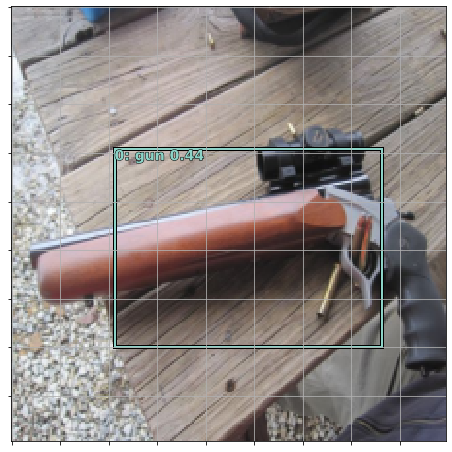

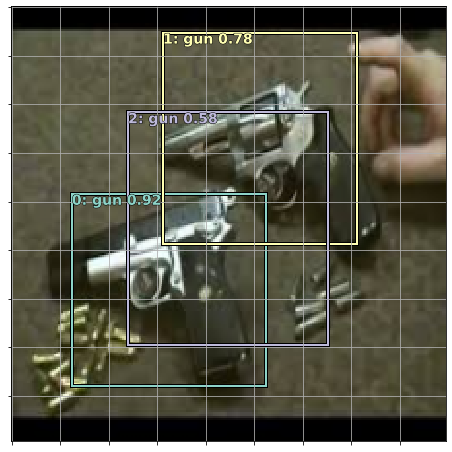

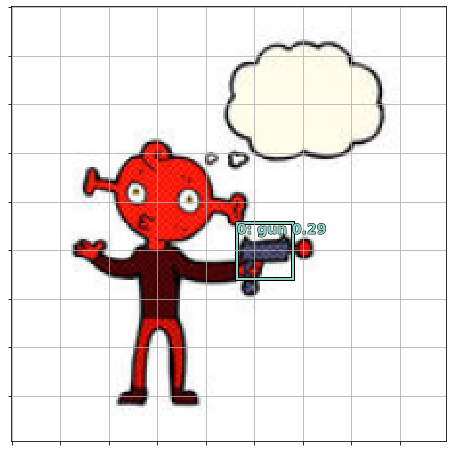

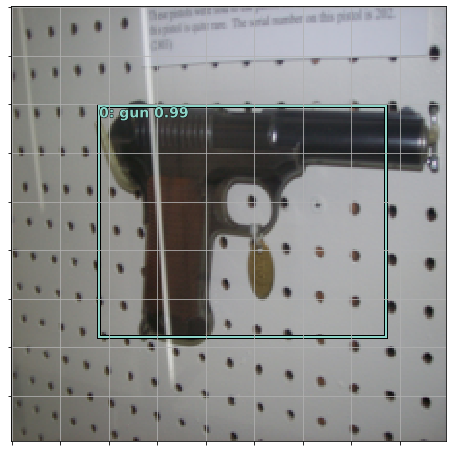

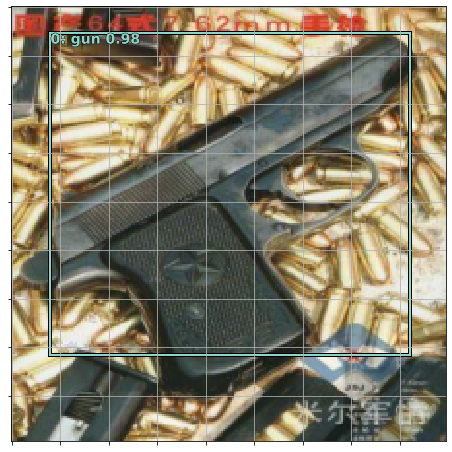

...

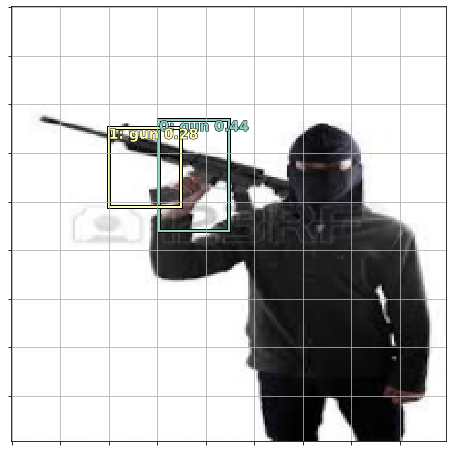

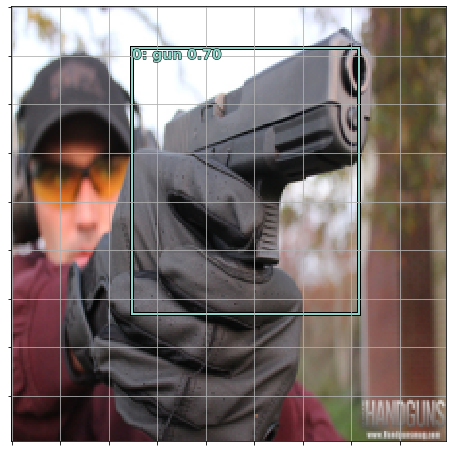

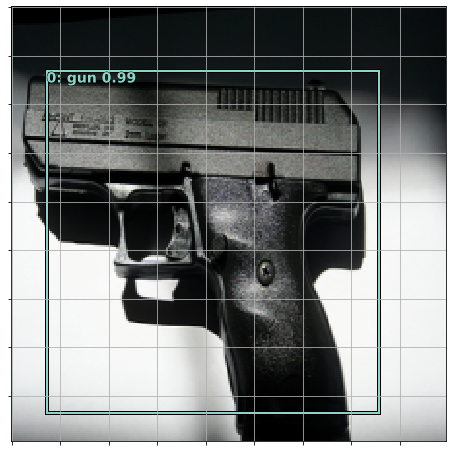

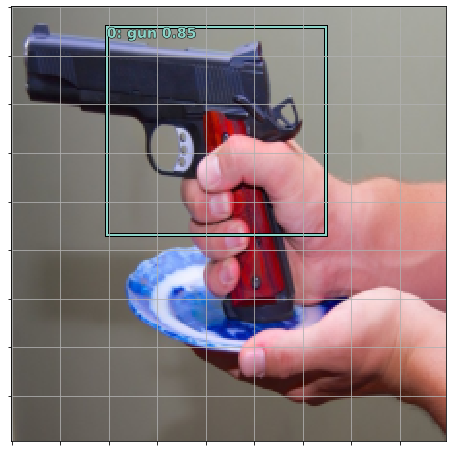

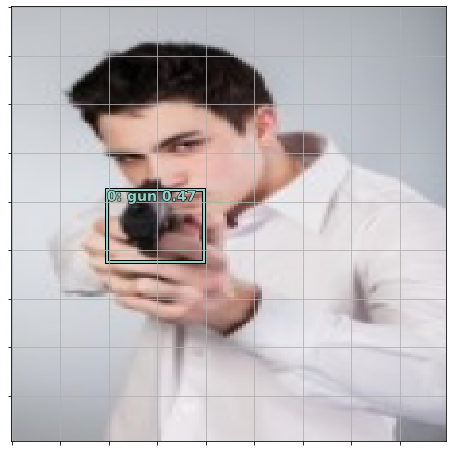

In [31]:
for i in range(100): show_nmf(i)

In [33]:
############## OPENPOSE ###################

In [34]:
def op_img(img,folder="testing/"):
    parser = argparse.ArgumentParser()
    parser.add_argument("--image_path", default="/media/antonio/ubuntuhdd/data/"+folder+img, help="Process an image. Read all standard formats (jpg, png, bmp, etc.).")
    parser.add_argument("-num_scales","-1")
    args = parser.parse_known_args()

    params = dict()
    params["model_folder"] = "/media/antonio/ubuntuhdd/open2/openpose/models"
    try:

        # Starting OpenPose
        opWrapper = op.WrapperPython()
        opWrapper.configure(params)
        opWrapper.start()
          # Process Image
        datum = op.Datum()
        imageToProcess = cv2.imread(args[0].image_path)
        datum.cvInputData = imageToProcess
        opWrapper.emplaceAndPop([datum])
        return datum.poseKeypoints
    except Exception as e:
        # print(e)
        sys.exit(-1)
        
def draw_im_op(im,folder="testing/"):
    ann=op_img(im,folder)
    ax = show_img(im, figsize=(16,8),folder=folder)
    for person in ann:
        #for point in person:
            #ax.scatter(round(point[0]),round(point[1]),round(100*point[2]))
        #Head
        person_drawline(17,15,ax,person)
        person_drawline(15,0,ax,person)
        person_drawline(0,16,ax,person)
        person_drawline(16,18,ax,person)
        #Left arm
        person_drawline(0,1,ax,person)
        person_drawline(1,2,ax,person)
        person_drawline(2,3,ax,person)
        person_drawline(3,4,ax,person)
        #right arm
        person_drawline(1,5,ax,person)
        person_drawline(5,6,ax,person)
        person_drawline(6,7,ax,person)
        #Chest
        person_drawline(1,8,ax,person)
        #left leg
        person_drawline(8,9,ax,person)
        person_drawline(9,10,ax,person)
        person_drawline(10,11,ax,person)
        person_drawline(11,24,ax,person)
        person_drawline(11,22,ax,person)
        person_drawline(22,23,ax,person)
        #Right leg
        person_drawline(8,12,ax,person)
        person_drawline(12,13,ax,person)
        person_drawline(13,14,ax,person)
        person_drawline(14,21,ax,person)
        person_drawline(14,19,ax,person)
        person_drawline(19,20,ax,person)
    
def person_drawline(i,j,ax,person):
    x=person[i]
    y=person[j]
    if x[0] != 0.0 and x[1] != 0.0 and y[0] != 0.0 and y[1] != 0.0 :
        ax.plot([round(x[0]),round(y[0])], [round(x[1]),round(y[1])])
        
I_POSEPATH="poseImg/"
    
def get_array(strng):
    res=[]
    points=strng.split("\n")
    for p in points:
        res.append([get_coords(p)])
    return res
        
def get_coords(point):
    formatted_point=point.replace("]","").replace("[","")
   
    str_points=formatted_point.strip().split(" ")
    return [float(c)  for c in str_points if c !=""]

def get_relative_pixel(arr,w,h):
    res=[]
    for person in arr:
        p=[]
        for point in person:
            p.append([point[0]/w,point[1]/h])
        res.append(p)
    return res
    

In [35]:
op_data={}
with open('op.csv', mode='r') as infile:
    reader = csv.reader(infile)
    for row in reader:
        #op_data[row[0]]=row[1]
        w,h= Image.open(PATH+I_POSEPATH+row[0]).size
        op_data[row[0]]=get_relative_pixel(get_array(row[1]),w,h)
        
with open('op_n.csv', mode='r') as infile:
    reader = csv.reader(infile)
    for row in reader:
        #op_data[row[0]]=row[1]
        w,h= Image.open(PATH+I_POSEPATH+row[0]).size
        op_data[row[0]]=get_relative_pixel(get_array(row[1]),w,h)
fn=list(op_data.keys())
random.shuffle(fn)

In [36]:
def get_souspicious(file):
    if int(file[0:len(file)-4])< 3000:
        return 1.0
    else:
        return 0.0

In [37]:
def get_means():
    op_1x=[]
    op_1y=[]
    
    op_2x=[]
    op_2y=[]
    
    op_3x=[]
    op_3y=[]
    
    op_4x=[]
    op_4y=[]
    
    op_5x=[]
    op_5y=[]
    
    op_6x=[]
    op_6y=[]
    
    op_7x=[]
    op_7y=[]
    
    for file in fn:
        op_1x.append(op_data[file][1][0][0])
        op_1y.append(op_data[file][1][0][1])
        
        op_2x.append(op_data[file][2][0][0])
        op_2y.append(op_data[file][2][0][1])
        
        op_3x.append(op_data[file][3][0][0])
        op_3y.append(op_data[file][3][0][1])
        
        op_4x.append(op_data[file][4][0][0])
        op_4y.append(op_data[file][4][0][1])
        
        op_5x.append(op_data[file][5][0][0])
        op_5y.append(op_data[file][5][0][1])
        
        op_6x.append(op_data[file][6][0][0])
        op_6y.append(op_data[file][6][0][1])
        
        op_7x.append(op_data[file][7][0][0])
        op_7y.append(op_data[file][7][0][1])
    res={}
    res["1x"]=statistics.mean(op_1x)
    res["1y"]=statistics.mean(op_1y)
    
    res["2x"]=statistics.mean(op_2x)
    res["2y"]=statistics.mean(op_2y)
    
    res["3x"]=statistics.mean(op_3x)
    res["3y"]=statistics.mean(op_3y)
    
    res["4x"]=statistics.mean(op_4x)
    res["4y"]=statistics.mean(op_4y)
    
    res["5x"]=statistics.mean(op_5x)
    res["5y"]=statistics.mean(op_5y)
    
    res["6x"]=statistics.mean(op_6x)
    res["6y"]=statistics.mean(op_6y)
    
    res["7x"]=statistics.mean(op_7x)
    res["7y"]=statistics.mean(op_7y)
    
    
    std={}
    std["1x"]=statistics.stdev(op_1x)
    std["1y"]=statistics.stdev(op_1y)
    
    std["2x"]=statistics.stdev(op_2x)
    std["2y"]=statistics.stdev(op_2y)
    
    std["3x"]=statistics.stdev(op_3x)
    std["3y"]=statistics.stdev(op_3y)
    
    std["4x"]=statistics.stdev(op_4x)
    std["4y"]=statistics.stdev(op_4y)
    
    std["5x"]=statistics.stdev(op_5x)
    std["5y"]=statistics.stdev(op_5y)
    
    std["6x"]=statistics.stdev(op_6x)
    std["6y"]=statistics.stdev(op_6y)
    
    std["7x"]=statistics.stdev(op_7x)
    std["7y"]=statistics.stdev(op_7y)
    
    return res,std
def normalize(arr):
    means,std=get_means()
    res=[]
    
    res.append((arr[0]-means["1x"])/std["1x"])
    res.append((arr[1]-means["1y"])/std["1y"])
    
    res.append((arr[2]-means["2x"])/std["2x"])
    res.append((arr[3]-means["2y"])/std["2y"])
    
    res.append((arr[4]-means["3x"])/std["3x"])
    res.append((arr[5]-means["3y"])/std["3y"])
    
    res.append((arr[6]-means["4x"])/std["4x"])
    res.append((arr[7]-means["4y"])/std["4y"])
    
    res.append((arr[8]-means["5x"])/std["5x"])
    res.append((arr[9]-means["5y"])/std["5y"])
    
    res.append((arr[10]-means["6x"])/std["6x"])
    res.append((arr[11]-means["6y"])/std["6y"])
    
    res.append((arr[12]-means["7x"])/std["7x"])
    res.append((arr[13]-means["7y"])/std["7y"])
    return res
    

In [38]:
OP_CSV = PATH+'/tmp/openpose.csv'
df = pd.DataFrame({'fn': fn, 'op_1x': [op_data[file][1][0][0] for file in fn] ,'op_1y': [op_data[file][1][0][1] for file in fn] , 'op_2x': [op_data[file][2][0][0] for file in fn] ,'op_2y': [op_data[file][2][0][1] for file in fn] , 'op_3x': [op_data[file][3][0][0] for file in fn] , 'op_3y': [op_data[file][3][0][1] for file in fn] , 'op_4x': [op_data[file][4][0][0] for file in fn] ,'op_4y': [op_data[file][4][0][1] for file in fn] , 'op_5x': [op_data[file][5][0][0] for file in fn] , 'op_5y': [op_data[file][5][0][1] for file in fn] , 'op_6x': [op_data[file][6][0][0] for file in fn] , 'op_6y': [op_data[file][6][0][1] for file in fn] , 'op_7x': [op_data[file][7][0][0] for file in fn], 'op_7y': [op_data[file][7][0][1] for file in fn],  'souspicious': [get_souspicious(file) for file in fn]}, columns=['fn','op_1x','op_1y','op_2x','op_2y','op_3x','op_3y','op_4x','op_4y','op_5x','op_5y','op_6x','op_6y','op_7x','op_7y','souspicious'])

#df = pd.DataFrame({'fn': [str(o)+".jpg" for o in range(0,3000)], 'bbox': [str_from_array(bb_sizes[str(o)]) for o in range(0,3000)]}, columns=['fn','bbox'])
df.to_csv(OP_CSV, index=False)

In [39]:
contin_vars=["op_1x", "op_1y","op_2x", "op_2y","op_3x", "op_3y","op_4x", "op_4y", "op_5x", "op_5y", "op_6x","op_6y","op_7x","op_7y"]
joined=df[contin_vars+["souspicious"]]
joined

,op_1x,op_1y,op_2x,op_2y,op_3x,op_3y,op_4x,op_4y,op_5x,op_5y,op_6x,op_6y,op_7x,op_7y,souspicious
0,0.156322,0.561225,0.126066,0.558537,0.103844,0.661894,0.172515,0.593859,0.186695,0.566661,0.249328,0.531285,0.305845,0.463284,0.0
1,0.578871,0.478839,0.477726,0.484380,0.316026,0.589516,0.289627,0.371037,0.688073,0.476128,0.785190,0.713924,0.734635,0.542578,1.0
2,0.507252,0.477672,0.276982,0.463694,0.180536,0.606019,0.415022,0.502889,0.737474,0.477704,0.816981,0.491652,0.687303,0.569884,1.0
3,0.464300,0.536277,0.308214,0.565828,0.281541,0.896113,0.175104,0.692015,0.625783,0.501358,0.735807,0.767216,0.813847,0.616764,1.0
4,0.510087,0.185844,0.476423,0.185843,0.459506,0.267285,0.471823,0.289138,0.545256,0.185792,0.556039,0.272876,0.568205,0.348935,0.0
5,0.642487,0.226828,0.604279,0.251344,0.558419,0.319239,0.520217,0.270104,0.682192,0.204836,0.738797,0.262068,0.728116,0.316411,0.0
6,0.554176,0.578111,0.385493,0.624678,0.335315,0.808325,0.459784,0.756138,0.700791,0.550699,0.759035,0.753503,0.000000,0.000000,1.0
7,0.179640,0.136766,0.213357,0.142094,0.312978,0.207529,0.395743,0.191205,0.141283,0.123111,0.000000,0.000000,0.000000,0.000000,0.0
8,0.546006,0.422885,0.547556,0.390177,0.519896,0.529087,0.446382,0.640767,0.545974,0.447354,0.509238,0.624500,0.440216,0.728162,0.0
9,0.480065,0.515017,0.349539,0.495910,0.223037,0.822234,0.221131,0.650872,0.616684,0.536725,0.659563,0.816860,0.504477,0.727004,0.0


In [40]:
dff, y, nas,mapper = proc_df(joined, 'souspicious',do_scale=True)

md = ColumnarModelData.from_data_frame(PATH, range(0,100), dff, y.astype(np.float32),[], bs=128)
m = md.get_learner([], len(df.columns)-2,
                   0.04, 1, [], [0.001,0.01],y_range=[0,1])


In [42]:
m.load("buen_openpose")   #carga modelo con buen rendimiento ya entrenado

In [90]:
m.fit(0.0001, 3000)

epoch      trn_loss   val_loss                   
    0      0.266314   0.277498  
    1      0.267261   0.277242                   
    2      0.267214   0.276983                   
    3      0.266618   0.276721                   
    4      0.266458   0.276466                   
    5      0.266365   0.276205                   
    6      0.266391   0.275948                   
    7      0.26627    0.275694                   
    8      0.266406   0.275434                   
    9      0.265795   0.275178                   
    10     0.26566    0.274928                   
    11     0.265621   0.274668                   
    12     0.265645   0.27442                    
    13     0.265609   0.27417                    
    14     0.265878   0.273923                   
    15     0.26559    0.273672                   
    16     0.265693   0.273424                   
    17     0.265587   0.273171                   
    18     0.265419   0.272922                   
    19     0.2651

   326     0.218656   0.206722                   
   327     0.218776   0.206548                   
   328     0.218468   0.20638                    
   329     0.218492   0.20621                    
   330     0.218085   0.206031                   
   331     0.218083   0.205858                   
   332     0.21809    0.205685                   
   333     0.218182   0.205519                   
   334     0.217961   0.205349                   
   335     0.217785   0.205176                   
   336     0.21777    0.205006                   
   337     0.217554   0.204836                   
   338     0.217315   0.204666                   
   339     0.217072   0.204501                   
   340     0.217032   0.204336                   
   341     0.217095   0.204159                   
   342     0.216922   0.203991                   
   343     0.216925   0.203828                   
   344     0.216598   0.203657                   
   345     0.216469   0.20349                    


   652     0.189527   0.165622                   
   653     0.18936    0.165537                   
   654     0.189314   0.165456                   
   655     0.189189   0.165367                   
   656     0.189177   0.165287                   
   657     0.189026   0.165205                   
   658     0.188999   0.16512                    
   659     0.188964   0.165033                   
   660     0.188842   0.16495                    
   661     0.18875    0.164866                   
   662     0.188651   0.164783                   
   663     0.188689   0.1647                     
   664     0.188449   0.164622                   
   665     0.188638   0.164536                   
   666     0.18874    0.164456                   
   667     0.188537   0.164374                   
   668     0.188484   0.164292                   
   669     0.188197   0.164208                   
   670     0.188156   0.164128                   
   671     0.188188   0.16405                    


   978     0.174465   0.147143                   
   979     0.174447   0.147106                   
   980     0.174599   0.147065                   
   981     0.174835   0.147037                   
   982     0.174608   0.147                      
   983     0.174452   0.146966                   
   984     0.174528   0.146925                   
   985     0.174352   0.146895                   
   986     0.174534   0.146861                   
   987     0.17463    0.146828                   
   988     0.17475    0.146792                   
   989     0.174681   0.146759                   
   990     0.174581   0.146724                   
   991     0.174622   0.146691                   
   992     0.174585   0.146655                   
   993     0.174478   0.146622                   
   994     0.174486   0.146594                   
   995     0.174296   0.146561                   
   996     0.174519   0.146522                   
   997     0.174371   0.146491                   


   1304    0.166064   0.139613                   
   1305    0.166106   0.139599                   
   1306    0.166066   0.139579                   
   1307    0.16605    0.139567                   
   1308    0.165962   0.139553                   
   1309    0.166063   0.139532                   
   1310    0.16604    0.139519                   
   1311    0.166078   0.139506                   
   1312    0.166004   0.139489                   
   1313    0.165857   0.139479                   
   1314    0.165753   0.139464                   
   1315    0.165928   0.139451                   
   1316    0.165802   0.139434                   
   1317    0.165853   0.139419                   
   1318    0.165855   0.139399                   
   1319    0.16586    0.139387                   
   1320    0.166006   0.139373                   
   1321    0.166019   0.139359                   
   1322    0.166071   0.139348                   
   1323    0.166027   0.139334                   


   1630    0.160425   0.136153                   
   1631    0.160361   0.136143                   
   1632    0.160271   0.136131                   
   1633    0.160239   0.136124                   
   1634    0.160134   0.136117                   
   1635    0.160125   0.13611                    
   1636    0.160095   0.136105                   
   1637    0.160255   0.136096                   
   1638    0.160151   0.136087                   
   1639    0.160102   0.136078                   
   1640    0.160318   0.13607                    
   1641    0.160364   0.136063                   
   1642    0.16034    0.136058                   
   1643    0.160091   0.136056                   
   1644    0.159941   0.136049                   
   1645    0.160201   0.136041                   
   1646    0.159945   0.136034                   
   1647    0.16016    0.136025                   
   1648    0.160273   0.136015                   
   1649    0.160055   0.136006                   


   1956    0.155256   0.134213                   
   1957    0.155276   0.134206                   
   1958    0.15543    0.134207                   
   1959    0.155659   0.134201                   
   1960    0.155878   0.134198                   
   1961    0.155814   0.134191                   
   1962    0.155791   0.13419                    
   1963    0.155842   0.134182                   
   1964    0.156173   0.134177                   
   1965    0.156098   0.134175                   
   1966    0.156124   0.134174                   
   1967    0.155969   0.134165                   
   1968    0.155796   0.134166                   
   1969    0.155937   0.134163                   
   1970    0.155914   0.134161                   
   1971    0.155858   0.13416                    
   1972    0.155936   0.134155                   
   1973    0.155979   0.134153                   
   1974    0.155833   0.134147                   
   1975    0.155874   0.134143                   


   2282    0.152521   0.133074                   
   2283    0.152751   0.13307                    
   2284    0.152943   0.133066                   
   2285    0.152814   0.133067                   
   2286    0.152773   0.133063                   
   2287    0.152825   0.133059                   
   2288    0.152695   0.133054                   
   2289    0.15288    0.133052                   
   2290    0.152546   0.13305                    
   2291    0.152496   0.133049                   
   2292    0.152604   0.133048                   
   2293    0.152754   0.133042                   
   2294    0.152664   0.133043                   
   2295    0.152463   0.133041                   
   2296    0.152472   0.133042                   
   2297    0.152564   0.133037                   
   2298    0.152502   0.133031                   
   2299    0.152697   0.133027                   
   2300    0.15273    0.13303                    
   2301    0.152505   0.133025                   


   2608    0.150441   0.132342                   
   2609    0.150428   0.132339                   
   2610    0.150339   0.132339                   
   2611    0.150577   0.13234                    
   2612    0.150775   0.132339                   
   2613    0.150382   0.132341                   
   2614    0.150278   0.132343                   
   2615    0.150193   0.132338                   
   2616    0.150231   0.13233                    
   2617    0.150373   0.132329                   
   2618    0.150288   0.132331                   
   2619    0.150527   0.132336                   
   2620    0.150687   0.132329                   
   2621    0.150644   0.132323                   
   2622    0.150505   0.132325                   
   2623    0.150194   0.132324                   
   2624    0.149997   0.132325                   
   2625    0.150281   0.132321                   
   2626    0.150184   0.132319                   
   2627    0.150136   0.13232                    


   2934    0.148103   0.13187                    
   2935    0.148399   0.131865                   
   2936    0.148179   0.131866                   
   2937    0.148389   0.131865                   
   2938    0.148468   0.13186                    
   2939    0.14828    0.131861                   
   2940    0.148258   0.131857                   
   2941    0.148164   0.131856                   
   2942    0.148037   0.131855                   
   2943    0.148328   0.131856                   
   2944    0.148521   0.131855                   
   2945    0.148527   0.131854                   
   2946    0.148431   0.131851                   
   2947    0.148231   0.131847                   
   2948    0.148068   0.131845                   
   2949    0.147937   0.13185                    
   2950    0.147897   0.13185                    
   2951    0.147952   0.131845                   
   2952    0.148109   0.131844                   
   2953    0.147758   0.131843                   


[array([0.1318])]

In [43]:
def img_souspicious(img,folder="testing/"):
    bodyPoints=op_img(img,folder)
    ax = show_img(img, figsize=(16,8),folder=folder)
    w,h= Image.open(PATH+folder+img).size
    for bp in bodyPoints:

        arms_bodypoints=[[bp[1][0]/w, bp[1][1]/h, bp[2][0]/w, bp[2][1]/h, bp[3][0]/w, bp[3][1]/h, bp[4][0]/w, bp[4][1]/h, bp[5][0]/w, bp[5][1]/h, bp[6][0]/w,bp[6][1]/h,bp[7][0]/w,bp[7][1]/h]]
        n=normalize(arms_bodypoints[0])
        souspicious=m.predict_array([0],[n])[0][0]
        print(souspicious)
        if souspicious >0.45:
            ax.text(bp[1][0],bp[1][1],"souspicious:" + str(souspicious),color="red",fontSize=15)
        else:
            ax.text(bp[1][0],bp[1][1],"not souspicious:" + str(souspicious),color="green",fontSize=15)

     

In [44]:
def op_img_streaming(img):
    parser = argparse.ArgumentParser()
    #parser.add_argument("-net_resolution","-1x300")
    args = parser.parse_known_args()

    params = dict()
    params["model_folder"] = "/media/antonio/ubuntuhdd/open2/openpose/models"
    try:

        # Starting OpenPose
        opWrapper = op.WrapperPython()
        opWrapper.configure(params)
        opWrapper.start()
          # Process Image
        datum = op.Datum()
        imageToProcess = img
        datum.cvInputData = imageToProcess
        opWrapper.emplaceAndPop([datum])
        return datum.poseKeypoints
    except Exception as e:
        # print(e)
        sys.exit(-1)
        
def img_souspicious_streaming(img):
    bodyPoints=op_img_streaming(img)
    fig,ax = plt.subplots()
    ax.imshow(img)
    w,h= 1920,1080
    if bodyPoints.any()!=0.0:
        for bp in bodyPoints:

            arms_bodypoints=[[bp[1][0]/w, bp[1][1]/h, bp[2][0]/w, bp[2][1]/h, bp[3][0]/w, bp[3][1]/h, bp[4][0]/w, bp[4][1]/h, bp[5][0]/w, bp[5][1]/h, bp[6][0]/w,bp[6][1]/h,bp[7][0]/w,bp[7][1]/h]]
            n=normalize(arms_bodypoints[0])
            souspicious=m.predict_array([0],[n])[0][0]
            print(souspicious)
            if souspicious >0.40:
                ax.text(bp[1][0],bp[1][1],"souspicious:" + str(souspicious),color="red",fontSize=15)
            else:
                ax.text(bp[1][0],bp[1][1],"not souspicious:" + str(souspicious),color="green",fontSize=15)
    return ax

0.074396305
0.070514895
0.07130116
0.078297086
0.08571352
0.07714782
0.07446137
0.06799349
0.12801227
0.22175118
0.27984393
0.31825382
0.30477992
0.16671827
0.06326742
0.08152997
0.52650744
0.68734056


/media/antonio/ubuntuhdd/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


0.43261728
0.5016586
0.57590896
0.6694844
0.7077353
0.89302516
0.74586785
0.7604874
0.75465816
0.73191655
0.7279456
0.7327538
0.8466103
0.53385866
0.829684
0.8241816
0.7967265
0.70334804
0.7712115
0.5642211
0.61251086
0.59622145
0.5839332
0.58283496
0.5815453
0.6011285
0.5989756
0.5389872
0.45651016
0.45757064
0.45467108
0.47656187
0.58900565
0.60656446
0.65247494
0.61656225
0.55967987
0.53279054
0.57081157
0.5631371
0.5755964
0.603648
0.76371
0.8856127
0.9153159
0.9157848
0.91314936
0.9094397
0.9050047
0.8701935
0.68811363
0.4574979
0.43525714
0.4043748
0.38766778
0.38763702
0.86198956
0.45704383
0.49104694
0.20432666
0.059807435
0.020033488
0.019484246
0.019440003
0.018502934
0.01710825
0.054285813
0.081777655
0.36041144
0.46503246
0.54256725
0.57904965
0.33104876
0.3346615
0.29360938
0.657671
0.84371
0.019487556
0.7758871
0.88570654
0.5562007
0.56285655
0.30740628
0.12766358
0.07890516
0.05033348
0.053338934
0.06596236
0.07242796
0.0818713
0.101162374
0.096643984
0.09320658
0.095134

SystemExit: -1

/media/antonio/ubuntuhdd/anaconda3/envs/fastai/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3304: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


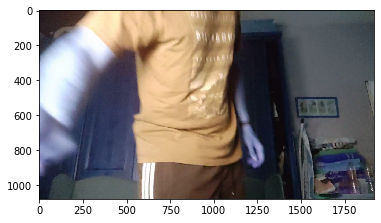

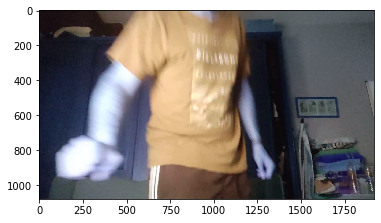

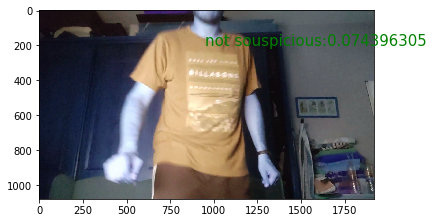

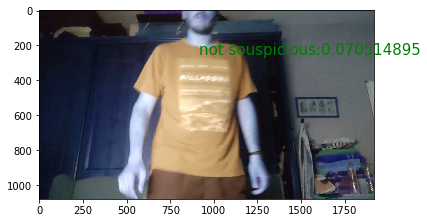

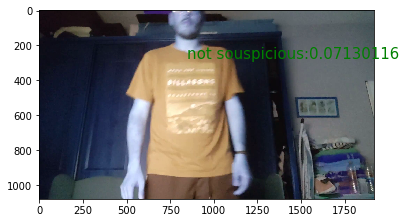

...

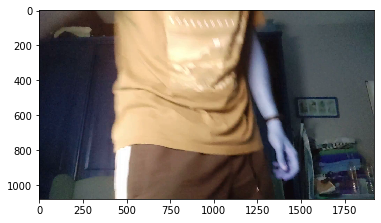

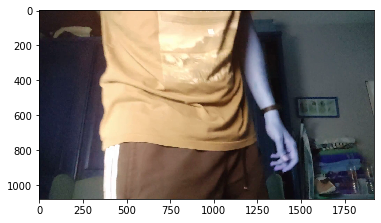

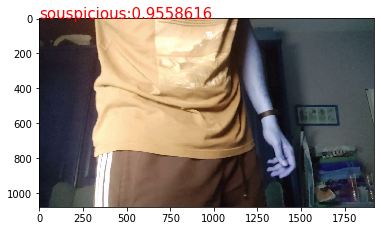

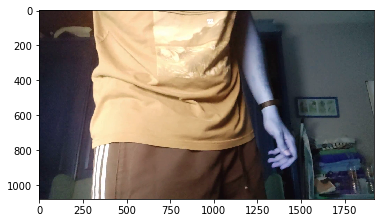

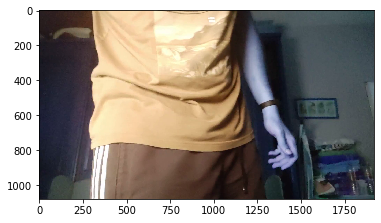

In [46]:
cap= cv2.VideoCapture(PATH+'testing/'+'yovid.mp4')
currentFrame = 0
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()
    cap.read()
    cap.read()
    # Handles the mirroring of the current frame

    # Our operations on the frame come here
    ax=img_souspicious_streaming(frame)
    
    
    ax.figure.savefig('frame' + str(currentFrame) + '.png')
    # Saves image of the current frame in jpg file
    # name = 'frame' + str(currentFrame) + '.jpg'
    # cv2.imwrite(name, frame)

    # Display the resulting frame
    i = cv2.imread('frame' + str(currentFrame) + '.png')
    cv2.imshow('streaming',i)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    # To stop duplicate images
    currentFrame += 1

# When everything done, release the capture
cap.release()
cv2.destroyAllWindows()